In [0]:
from pyspark.sql.functions import col
from pyspark.sql.functions import sum, avg
from pyspark.sql.window import Window
from pyspark.sql.functions import when
from pyspark.sql.functions import year, month, dayofmonth
from pyspark.sql.functions import lower, regexp_replace
from pyspark.sql.functions import current_date
import matplotlib.pyplot as plt
import seaborn as sns
from pyspark.sql.functions import count, desc





In [0]:
# Import the SparkSession class from PySpark SQL module
# This is the entry point to all Spark functionality
from pyspark.sql import SparkSession

# Create SparkSession
# SparkSession is the unified entry point for reading data, executing SQL, and more
spark = SparkSession.builder.appName("IPL Data Analysis").getOrCreate()       

In [0]:
# Define the path to the Ball-by-Ball data file in the Databricks Volume
# Using Volumes provides centralized, managed storage for your project data
file_path = "/Volumes/workspace/ipl_data_analysis_project/data_files/Ball_By_Ball.csv"

# Read the CSV file into a PySpark DataFrame using a structured approach
ball_by_ball_df = (spark.read
      .format("csv")                   # Specify the file format as CSV
      .option("header", "true")        # Treat first row as column headers
      .option("inferSchema", "true")   # Automatically detect column data types (int, string, etc.)
      .load(file_path)                 # Load data from the specified file path
     )



In [0]:
# Display the DataFrame
display(ball_by_ball_df)



MatcH_id,Over_id,Ball_id,Innings_No,Team_Batting,Team_Bowling,Striker_Batting_Position,Extra_Type,Runs_Scored,Extra_runs,Wides,Legbyes,Byes,Noballs,Penalty,Bowler_Extras,Out_type,Caught,Bowled,Run_out,LBW,Retired_hurt,Stumped,caught_and_bowled,hit_wicket,ObstructingFeild,Bowler_Wicket,Match_Date,Season,Striker,Non_Striker,Bowler,Player_Out,Fielders,Striker_match_SK,StrikerSK,NonStriker_match_SK,NONStriker_SK,Fielder_match_SK,Fielder_SK,Bowler_match_SK,BOWLER_SK,PlayerOut_match_SK,BattingTeam_SK,BowlingTeam_SK,Keeper_Catch,Player_out_sk,MatchDateSK
598028,15,6,1,5,2,6,No Extras,4,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2013-04-20,2013,277,104,83,null,null,20336,276,20333,103,-1,-1,20343,82,-1,4,1,false,0,20130420
598028,14,1,1,5,2,5,No Extras,1,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2013-04-20,2013,104,6,346,null,null,20333,103,20328,5,-1,-1,20348,345,-1,4,1,false,0,20130420
598028,14,2,1,5,2,3,No Extras,1,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2013-04-20,2013,6,104,346,null,null,20328,5,20333,103,-1,-1,20348,345,-1,4,1,false,0,20130420
598028,14,3,1,5,2,5,No Extras,1,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2013-04-20,2013,104,6,346,null,null,20333,103,20328,5,-1,-1,20348,345,-1,4,1,false,0,20130420
598028,14,4,1,5,2,3,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2013-04-20,2013,6,104,346,null,null,20328,5,20333,103,-1,-1,20348,345,-1,4,1,false,0,20130420
598028,14,5,1,5,2,3,No Extras,4,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2013-04-20,2013,6,104,346,null,null,20328,5,20333,103,-1,-1,20348,345,-1,4,1,false,0,20130420
598028,14,6,1,5,2,3,No Extras,2,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2013-04-20,2013,6,104,346,null,null,20328,5,20333,103,-1,-1,20348,345,-1,4,1,false,0,20130420
598028,13,1,1,5,2,5,No Extras,1,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2013-04-20,2013,104,6,83,null,null,20333,103,20328,5,-1,-1,20343,82,-1,4,1,false,0,20130420
598028,13,2,1,5,2,3,No Extras,4,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2013-04-20,2013,6,104,83,null,null,20328,5,20333,103,-1,-1,20343,82,-1,4,1,false,0,20130420
598028,13,3,1,5,2,3,No Extras,1,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2013-04-20,2013,6,104,83,null,null,20328,5,20333,103,-1,-1,20343,82,-1,4,1,false,0,20130420


In [0]:
# Define the path to the Match data file in the Databricks Volume
# This contains match information (teams, match id, date, etc.)
file_path = "/Volumes/workspace/ipl_data_analysis_project/data_files/Match.csv"

# Read the Match CSV file into a PySpark DataFrame
match_df = (spark.read
      .format("csv")                   # Specify CSV file format
      .option("header", "true")        # Use first row as column names
      .option("inferSchema", "true")   # Automatically infer data types for all columns
      .load(file_path)                 # Load from the specified file path
     )

In [0]:
# Display the DataFrame
display(match_df)

Match_SK,match_id,Team1,Team2,match_date,Season_Year,Venue_Name,City_Name,Country_Name,Toss_Winner,match_winner,Toss_Name,Win_Type,Outcome_Type,ManOfMach,Win_Margin,Country_id
0,335987,Royal Challengers Bangalore,Kolkata Knight Riders,2008-04-18,2008,M Chinnaswamy Stadium,Bangalore,India,Royal Challengers Bangalore,Kolkata Knight Riders,field,runs,Result,BB McCullum,140,1
1,335988,Kings XI Punjab,Chennai Super Kings,2008-04-19,2008,"Punjab Cricket Association Stadium, Mohali",Chandigarh,India,Chennai Super Kings,Chennai Super Kings,bat,runs,Result,MEK Hussey,33,1
2,335989,Delhi Daredevils,Rajasthan Royals,2008-04-19,2008,Feroz Shah Kotla,Delhi,India,Rajasthan Royals,Delhi Daredevils,bat,wickets,Result,MF Maharoof,9,1
3,335990,Mumbai Indians,Royal Challengers Bangalore,2008-04-20,2008,Wankhede Stadium,Mumbai,India,Mumbai Indians,Royal Challengers Bangalore,bat,wickets,Result,MV Boucher,5,1
4,335991,Kolkata Knight Riders,Deccan Chargers,2008-04-20,2008,Eden Gardens,Kolkata,India,Deccan Chargers,Kolkata Knight Riders,bat,wickets,Result,DJ Hussey,5,1
5,335992,Rajasthan Royals,Kings XI Punjab,2008-04-21,2008,Sawai Mansingh Stadium,Jaipur,India,Kings XI Punjab,Rajasthan Royals,bat,wickets,Result,SR Watson,6,1
6,335993,Deccan Chargers,Delhi Daredevils,2008-04-22,2008,"Rajiv Gandhi International Stadium, Uppal",Hyderabad,India,Deccan Chargers,Delhi Daredevils,bat,wickets,Result,V Sehwag,9,1
7,335994,Chennai Super Kings,Mumbai Indians,2008-04-23,2008,"MA Chidambaram Stadium, Chepauk",Chennai,India,Mumbai Indians,Chennai Super Kings,field,runs,Result,ML Hayden,6,1
8,335995,Deccan Chargers,Rajasthan Royals,2008-04-24,2008,"Rajiv Gandhi International Stadium, Uppal",Hyderabad,India,Rajasthan Royals,Rajasthan Royals,field,wickets,Result,YK Pathan,3,1
9,335996,Kings XI Punjab,Mumbai Indians,2008-04-25,2008,"Punjab Cricket Association Stadium, Mohali",Chandigarh,India,Mumbai Indians,Kings XI Punjab,field,runs,Result,KC Sangakkara,66,1


In [0]:
file_path = "/Volumes/workspace/ipl_data_analysis_project/data_files/Player.csv"

player_df = (spark.read
      .format("csv")
      .option("header", "true")       
      .option("inferSchema", "true")  
      .load(file_path)
     )

In [0]:
# Display the DataFrame
display(player_df)

PLAYER_SK,Player_Id,Player_Name,DOB,Batting_hand,Bowling_skill,Country_Name
0,1,SC Ganguly,1972-07-08,Left-hand bat,Right-arm medium,India
1,2,BB McCullum,1981-09-27,Right-hand bat,Right-arm medium,New Zealand
2,3,RT Ponting,1974-12-19,Right-hand bat,Right-arm medium,Australia
3,4,DJ Hussey,1977-07-15,Right-hand bat,Right-arm offbreak,Australia
4,5,Mohammad Hafeez,1980-10-17,Right-hand bat,Right-arm offbreak,Pakistan
5,6,R Dravid,1973-01-11,Right-hand bat,Right-arm offbreak,India
6,7,W Jaffer,1978-02-16,Right-hand bat,Right-arm offbreak,India
7,8,V Kohli,1988-11-05,Right-hand bat,Right-arm medium,India
8,9,JH Kallis,1975-10-16,Right-hand bat,Right-arm fast-medium,South Africa
9,10,CL White,1983-08-18,Right-hand bat,Legbreak googly,Australia


In [0]:
# Define the path to the Player data file in the Databricks Volume
# This contains player demographic and profile information
file_path = "/Volumes/workspace/ipl_data_analysis_project/data_files/Player_match.csv"

# Read the Player CSV file into a PySpark DataFrame
player_match_df = (spark.read
      .format("csv")                   # Specify CSV file format
      .option("header", "true")        # First row contains column headers
      .option("inferSchema", "true")   # Automatically detect data types (player_id, name, etc.)
      .load(file_path)                 # Load data from the specified path
     )

In [0]:
# Display the DataFrame
display(player_match_df)

Player_match_SK,PlayerMatch_key,Match_Id,Player_Id,Player_Name,DOB,Batting_hand,Bowling_skill,Country_Name,Role_Desc,Player_team,Opposit_Team,Season_year,is_manofThematch,Age_As_on_match,IsPlayers_Team_won,Batting_Status,Bowling_Status,Player_Captain,Opposit_captain,Player_keeper,Opposit_keeper
12694,33598700006,335987,6,R Dravid,1973-01-11,Right-hand bat,Right-arm offbreak,India,Captain,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,35,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12695,33598700007,335987,7,W Jaffer,1978-02-16,Right-hand bat,Right-arm offbreak,India,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,30,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12696,33598700008,335987,8,V Kohli,1988-11-05,Right-hand bat,Right-arm medium,India,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,20,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12697,33598700009,335987,9,JH Kallis,1975-10-16,Right-hand bat,Right-arm fast-medium,South Africa,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,33,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12698,33598700010,335987,10,CL White,1983-08-18,Right-hand bat,Legbreak googly,Australia,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,25,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12699,33598700011,335987,11,MV Boucher,1976-12-03,Right-hand bat,Right-arm medium,South Africa,Keeper,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,32,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12700,33598700012,335987,12,B Akhil,1977-10-07,Right-hand bat,Right-arm medium-fast,India,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,31,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12701,33598700013,335987,13,AA Noffke,1977-04-30,Right-hand bat,Right-arm fast-medium,Australia,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,31,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12702,33598700014,335987,14,P Kumar,1986-10-02,Right-hand bat,Right-arm medium,India,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,22,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12703,33598700015,335987,15,Z Khan,1978-10-07,Right-hand bat,Left-arm fast-medium,India,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,30,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha


In [0]:
# Define the path to the Team data file in the Databricks Volume
# This contains team information and identifiers
file_path = "/Volumes/workspace/ipl_data_analysis_project/data_files/Team.csv"

# Read the Team CSV file into a PySpark DataFrame
team_df = (spark.read
      .format("csv")                   # Specify CSV file format
      .option("header", "true")        # First row contains column names
      .option("inferSchema", "true")   # Automatically detect data types for team attributes
      .load(file_path)                 # Load data from the specified file path
     )

In [0]:
# Display the DataFrame
display(team_df)

Team_SK,Team_Id,Team_Name
0,1,Kolkata Knight Riders
1,2,Royal Challengers Bangalore
2,3,Chennai Super Kings
3,4,Kings XI Punjab
4,5,Rajasthan Royals
5,6,Delhi Daredevils
6,7,Mumbai Indians
7,8,Deccan Chargers
8,9,Kochi Tuskers Kerala
9,10,Pune Warriors


In [0]:
# filter to include only valid deliveries (excluding extras like wides and no balls for specific analysis)

ball_by_ball_df = ball_by_ball_df.filter((col("wides") == 0) & (col("noballs") == 0))

In [0]:
# calculate the total and the average runs scored in each match and inning 

total_and_avg_runs = ball_by_ball_df.groupBy("MatcH_id","Innings_No").agg(
    sum("Runs_Scored").alias("total_runs"),
    avg("Runs_Scored").alias("average_runs")
    )
                     

In [0]:
display(total_and_avg_runs)

MatcH_id,Innings_No,total_runs,average_runs
548339,1,156,1.3109243697478992
548330,1,83,0.7155172413793104
548351,2,91,0.8348623853211009
980942,2,163,1.393162393162393
548328,2,123,1.025
734018,2,129,1.084033613445378
548344,2,161,1.3529411764705883
548316,2,115,1.116504854368932
729316,1,129,1.075
980966,1,143,1.1916666666666667


In [0]:
# calculate running total of runs scored for each match for each over

window_spec = Window.partitionBy("MatcH_id","Innings_No").orderBy("Over_id")

ball_by_ball_df = ball_by_ball_df.withColumn(
    "running_total_runs",
    sum("Runs_Scored").over(window_spec))


In [0]:
display(ball_by_ball_df)

MatcH_id,Over_id,Ball_id,Innings_No,Team_Batting,Team_Bowling,Striker_Batting_Position,Extra_Type,Runs_Scored,Extra_runs,Wides,Legbyes,Byes,Noballs,Penalty,Bowler_Extras,Out_type,Caught,Bowled,Run_out,LBW,Retired_hurt,Stumped,caught_and_bowled,hit_wicket,ObstructingFeild,Bowler_Wicket,Match_Date,Season,Striker,Non_Striker,Bowler,Player_Out,Fielders,Striker_match_SK,StrikerSK,NonStriker_match_SK,NONStriker_SK,Fielder_match_SK,Fielder_SK,Bowler_match_SK,BOWLER_SK,PlayerOut_match_SK,BattingTeam_SK,BowlingTeam_SK,Keeper_Catch,Player_out_sk,MatchDateSK,running_total_runs
335987,1,1,1,1,2,1,legbyes,0,1,0,1,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,1,2,14,null,null,12705,0,12706,1,-1,-1,12702,13,-1,0,1,false,0,20080418,0
335987,1,2,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,20080418,0
335987,1,4,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,20080418,0
335987,1,5,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,20080418,0
335987,1,6,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,20080418,0
335987,1,7,1,1,2,2,legbyes,0,1,0,1,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,20080418,0
335987,2,1,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,15,null,null,12706,1,12705,0,-1,-1,12703,14,-1,0,1,false,0,20080418,18
335987,2,2,1,1,2,2,No Extras,4,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,15,null,null,12706,1,12705,0,-1,-1,12703,14,-1,0,1,false,0,20080418,18
335987,2,3,1,1,2,2,No Extras,4,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,15,null,null,12706,1,12705,0,-1,-1,12703,14,-1,0,1,false,0,20080418,18
335987,2,4,1,1,2,2,No Extras,6,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,15,null,null,12706,1,12705,0,-1,-1,12703,14,-1,0,1,false,0,20080418,18


In [0]:
# flag for high impact balls (either a wicket or more than 6 runs including extras)

ball_by_ball_df = ball_by_ball_df.withColumn(
    "high_impact",
    when((col("Runs_Scored")  + col("Extra_runs") > 6) | col("Bowler_Wicket") == True , True).otherwise(False))


In [0]:
display(ball_by_ball_df)

MatcH_id,Over_id,Ball_id,Innings_No,Team_Batting,Team_Bowling,Striker_Batting_Position,Extra_Type,Runs_Scored,Extra_runs,Wides,Legbyes,Byes,Noballs,Penalty,Bowler_Extras,Out_type,Caught,Bowled,Run_out,LBW,Retired_hurt,Stumped,caught_and_bowled,hit_wicket,ObstructingFeild,Bowler_Wicket,Match_Date,Season,Striker,Non_Striker,Bowler,Player_Out,Fielders,Striker_match_SK,StrikerSK,NonStriker_match_SK,NONStriker_SK,Fielder_match_SK,Fielder_SK,Bowler_match_SK,BOWLER_SK,PlayerOut_match_SK,BattingTeam_SK,BowlingTeam_SK,Keeper_Catch,Player_out_sk,MatchDateSK,running_total_runs,high_impact
335987,1,1,1,1,2,1,legbyes,0,1,0,1,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,1,2,14,null,null,12705,0,12706,1,-1,-1,12702,13,-1,0,1,false,0,20080418,0,false
335987,1,2,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,20080418,0,false
335987,1,4,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,20080418,0,false
335987,1,5,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,20080418,0,false
335987,1,6,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,20080418,0,false
335987,1,7,1,1,2,2,legbyes,0,1,0,1,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,20080418,0,false
335987,2,1,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,15,null,null,12706,1,12705,0,-1,-1,12703,14,-1,0,1,false,0,20080418,18,false
335987,2,2,1,1,2,2,No Extras,4,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,15,null,null,12706,1,12705,0,-1,-1,12703,14,-1,0,1,false,0,20080418,18,false
335987,2,3,1,1,2,2,No Extras,4,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,15,null,null,12706,1,12705,0,-1,-1,12703,14,-1,0,1,false,0,20080418,18,false
335987,2,4,1,1,2,2,No Extras,6,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,2008-04-18,2008,2,1,15,null,null,12706,1,12705,0,-1,-1,12703,14,-1,0,1,false,0,20080418,18,false


In [0]:
# Extracting year, month, and day from the match date for more detailed time-based analysis

match_df = match_df.withColumn("year", year("match_date"))
match_df = match_df.withColumn("month", month("match_date"))
match_df = match_df.withColumn("day", dayofmonth("match_date"))

In [0]:
# categorizing win margins into 'high', 'medium', and 'low'
match_df = match_df.withColumn(
    "win_margin_category",
    when(col("Win_Margin") >= 100, "High")
    .when((col("Win_Margin") >= 50) & (col("Win_Margin") < 100), "Medium")
    .otherwise("Low")
)



In [0]:
# Analyze the impact of the toss: who wins the toss and the match
match_df = match_df.withColumn(
    "toss_match_winner",
    when(col("Toss_Winner") == col("match_winner"), "Yes").otherwise("No")
)

In [0]:
display(match_df)

Match_SK,match_id,Team1,Team2,match_date,Season_Year,Venue_Name,City_Name,Country_Name,Toss_Winner,match_winner,Toss_Name,Win_Type,Outcome_Type,ManOfMach,Win_Margin,Country_id,year,month,day,win_margin_category,toss_match_winner
0,335987,Royal Challengers Bangalore,Kolkata Knight Riders,2008-04-18,2008,M Chinnaswamy Stadium,Bangalore,India,Royal Challengers Bangalore,Kolkata Knight Riders,field,runs,Result,BB McCullum,140,1,2008,4,18,High,No
1,335988,Kings XI Punjab,Chennai Super Kings,2008-04-19,2008,"Punjab Cricket Association Stadium, Mohali",Chandigarh,India,Chennai Super Kings,Chennai Super Kings,bat,runs,Result,MEK Hussey,33,1,2008,4,19,Low,Yes
2,335989,Delhi Daredevils,Rajasthan Royals,2008-04-19,2008,Feroz Shah Kotla,Delhi,India,Rajasthan Royals,Delhi Daredevils,bat,wickets,Result,MF Maharoof,9,1,2008,4,19,Low,No
3,335990,Mumbai Indians,Royal Challengers Bangalore,2008-04-20,2008,Wankhede Stadium,Mumbai,India,Mumbai Indians,Royal Challengers Bangalore,bat,wickets,Result,MV Boucher,5,1,2008,4,20,Low,No
4,335991,Kolkata Knight Riders,Deccan Chargers,2008-04-20,2008,Eden Gardens,Kolkata,India,Deccan Chargers,Kolkata Knight Riders,bat,wickets,Result,DJ Hussey,5,1,2008,4,20,Low,No
5,335992,Rajasthan Royals,Kings XI Punjab,2008-04-21,2008,Sawai Mansingh Stadium,Jaipur,India,Kings XI Punjab,Rajasthan Royals,bat,wickets,Result,SR Watson,6,1,2008,4,21,Low,No
6,335993,Deccan Chargers,Delhi Daredevils,2008-04-22,2008,"Rajiv Gandhi International Stadium, Uppal",Hyderabad,India,Deccan Chargers,Delhi Daredevils,bat,wickets,Result,V Sehwag,9,1,2008,4,22,Low,No
7,335994,Chennai Super Kings,Mumbai Indians,2008-04-23,2008,"MA Chidambaram Stadium, Chepauk",Chennai,India,Mumbai Indians,Chennai Super Kings,field,runs,Result,ML Hayden,6,1,2008,4,23,Low,No
8,335995,Deccan Chargers,Rajasthan Royals,2008-04-24,2008,"Rajiv Gandhi International Stadium, Uppal",Hyderabad,India,Rajasthan Royals,Rajasthan Royals,field,wickets,Result,YK Pathan,3,1,2008,4,24,Low,Yes
9,335996,Kings XI Punjab,Mumbai Indians,2008-04-25,2008,"Punjab Cricket Association Stadium, Mohali",Chandigarh,India,Mumbai Indians,Kings XI Punjab,field,runs,Result,KC Sangakkara,66,1,2008,4,25,Medium,No


In [0]:
# Normalize and clean player names
player_df = player_df.withColumn(
    "player_name", 
    lower(regexp_replace("player_name", "[^a-zA-Z0-9 ]", ""))
    )


In [0]:
# Handle missing values in 'batting_hand' and 'bowling_skill' with a default 'unknown'
player_df = player_df.na.fill({"Batting_hand": "unknown", "Bowling_skill": "unknown"})


In [0]:
# Categorizing players based on batting hand
player_df = player_df.withColumn(
    "batting_style",
    when(col("Batting_hand").contains("Left"), "Left-Handed").otherwise("Right-Handed")
)

In [0]:
display(player_df)

PLAYER_SK,Player_Id,player_name,DOB,Batting_hand,Bowling_skill,Country_Name,batting_style
0,1,sc ganguly,1972-07-08,Left-hand bat,Right-arm medium,India,Left-Handed
1,2,bb mccullum,1981-09-27,Right-hand bat,Right-arm medium,New Zealand,Right-Handed
2,3,rt ponting,1974-12-19,Right-hand bat,Right-arm medium,Australia,Right-Handed
3,4,dj hussey,1977-07-15,Right-hand bat,Right-arm offbreak,Australia,Right-Handed
4,5,mohammad hafeez,1980-10-17,Right-hand bat,Right-arm offbreak,Pakistan,Right-Handed
5,6,r dravid,1973-01-11,Right-hand bat,Right-arm offbreak,India,Right-Handed
6,7,w jaffer,1978-02-16,Right-hand bat,Right-arm offbreak,India,Right-Handed
7,8,v kohli,1988-11-05,Right-hand bat,Right-arm medium,India,Right-Handed
8,9,jh kallis,1975-10-16,Right-hand bat,Right-arm fast-medium,South Africa,Right-Handed
9,10,cl white,1983-08-18,Right-hand bat,Legbreak googly,Australia,Right-Handed


In [0]:
# Add a 'veteran_status' column based on player age

player_match_df = player_match_df.withColumn(
    "veteran_status",
    when(col("Age_As_on_match") >= 35, "Veteran").otherwise("Non-Veteran")
)



In [0]:
# Dynamic column to calculate years since debut
player_match_df = player_match_df.withColumn(
    "years_since_debut",
    (year(current_date()) - col("Season_year"))
)

In [0]:
display(player_match_df)

Player_match_SK,PlayerMatch_key,Match_Id,Player_Id,Player_Name,DOB,Batting_hand,Bowling_skill,Country_Name,Role_Desc,Player_team,Opposit_Team,Season_year,is_manofThematch,Age_As_on_match,IsPlayers_Team_won,Batting_Status,Bowling_Status,Player_Captain,Opposit_captain,Player_keeper,Opposit_keeper,veteran_status,years_since_debut
12694,33598700006,335987,6,R Dravid,1973-01-11,Right-hand bat,Right-arm offbreak,India,Captain,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,35,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha,Veteran,17
12695,33598700007,335987,7,W Jaffer,1978-02-16,Right-hand bat,Right-arm offbreak,India,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,30,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha,Non-Veteran,17
12696,33598700008,335987,8,V Kohli,1988-11-05,Right-hand bat,Right-arm medium,India,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,20,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha,Non-Veteran,17
12697,33598700009,335987,9,JH Kallis,1975-10-16,Right-hand bat,Right-arm fast-medium,South Africa,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,33,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha,Non-Veteran,17
12698,33598700010,335987,10,CL White,1983-08-18,Right-hand bat,Legbreak googly,Australia,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,25,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha,Non-Veteran,17
12699,33598700011,335987,11,MV Boucher,1976-12-03,Right-hand bat,Right-arm medium,South Africa,Keeper,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,32,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha,Non-Veteran,17
12700,33598700012,335987,12,B Akhil,1977-10-07,Right-hand bat,Right-arm medium-fast,India,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,31,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha,Non-Veteran,17
12701,33598700013,335987,13,AA Noffke,1977-04-30,Right-hand bat,Right-arm fast-medium,Australia,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,31,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha,Non-Veteran,17
12702,33598700014,335987,14,P Kumar,1986-10-02,Right-hand bat,Right-arm medium,India,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,22,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha,Non-Veteran,17
12703,33598700015,335987,15,Z Khan,1978-10-07,Right-hand bat,Left-arm fast-medium,India,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,30,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha,Non-Veteran,17


In [0]:
# Create temporary SQL views from DataFrames to enable SQL queries alongside PySpark operations
ball_by_ball_df.createOrReplaceTempView("ball_by_ball")  # Creates SQL view for ball_by_ball data
match_df.createOrReplaceTempView("match")                # Creates SQL view for match data  
player_df.createOrReplaceTempView("player")              # Creates SQL view for player data
player_match_df.createOrReplaceTempView("player_match")  # Creates SQL view for player_match  data
team_df.createOrReplaceTempView("team")                  # Creates SQL view for team data

In [0]:
# Calculate top scoring batsmen for each IPL season
top_scoring_batsmen_per_season = spark.sql("""
SELECT 
    p.player_name,                    -- Get the actual player name instead of ID
    m.season_year,                    -- Extract the year/season of the match
    SUM(b.runs_scored) AS total_runs  -- Calculate total runs scored by each player per season
FROM ball_by_ball b                   -- Start with ball-by-ball data (most granular level)
JOIN match m ON b.match_id = m.match_id       -- Join to get match details like season year  
JOIN player_match pm ON m.match_id = pm.match_id AND b.striker = pm.player_id  -- Link player to specific match
JOIN player p ON p.player_id = pm.player_id   -- Join to get player names from player IDs
GROUP BY p.player_name, m.season_year         -- Aggregate runs by player and season
ORDER BY m.season_year, total_runs DESC       -- Sort by season, then by runs (highest first)
""")

In [0]:
top_scoring_batsmen_per_season.show(30)


+---------------+-----------+----------+
|    player_name|season_year|total_runs|
+---------------+-----------+----------+
|       se marsh|       2008|       614|
|      g gambhir|       2008|       532|
|  st jayasuriya|       2008|       508|
|      sr watson|       2008|       463|
|       gc smith|       2008|       437|
|   ac gilchrist|       2008|       431|
|      yk pathan|       2008|       430|
|       sk raina|       2008|       420|
|       ms dhoni|       2008|       414|
|       v sehwag|       2008|       399|
|      rg sharma|       2008|       399|
|       r dravid|       2008|       370|
|     sc ganguly|       2008|       349|
|       s dhawan|       2008|       340|
|  kc sangakkara|       2008|       319|
|      dj hussey|       2008|       318|
|     rv uthappa|       2008|       316|
|    sa asnodkar|       2008|       311|
|   yuvraj singh|       2008|       299|
|       pa patel|       2008|       297|
|y venugopal rao|       2008|       283|
|      ja morkel

In [0]:
# Calculate comprehensive batting statistics
batsman_performance = spark.sql("""
    SELECT
        striker,
        SUM(runs_scored) AS total_runs,
        COUNT(MatcH_id) AS balls_faced, -- Using any non-null column for a robust count
        SUM(CASE WHEN runs_scored = 4 THEN 1 ELSE 0 END) AS fours,
        SUM(CASE WHEN runs_scored = 6 THEN 1 ELSE 0 END) AS sixes,
        (SUM(runs_scored) / COUNT(MatcH_id)) * 100 AS strike_rate
    FROM
        ball_by_ball
    GROUP BY
        striker
    ORDER BY
        total_runs DESC
""")


In [0]:
# Get the top 10 batsmen by total runs
top_10_batsmen = batsman_performance.limit(10)

# Display the results
display(top_10_batsmen)


striker,total_runs,balls_faced,fours,sixes,strike_rate
21,4526,3251,400,173,139.21870193786526
8,4402,3393,383,158,129.73769525493663
57,4184,3203,351,172,130.6275366843584
40,4112,3306,482,57,124.37991530550514
187,3985,2809,399,157,141.86543253826983
46,3767,2855,376,125,131.94395796847635
162,3606,2394,295,261,150.6265664160401
20,3553,2593,251,156,137.02275356729658
42,3541,2913,398,70,121.55853072433918
110,3460,2340,286,155,147.86324786324786


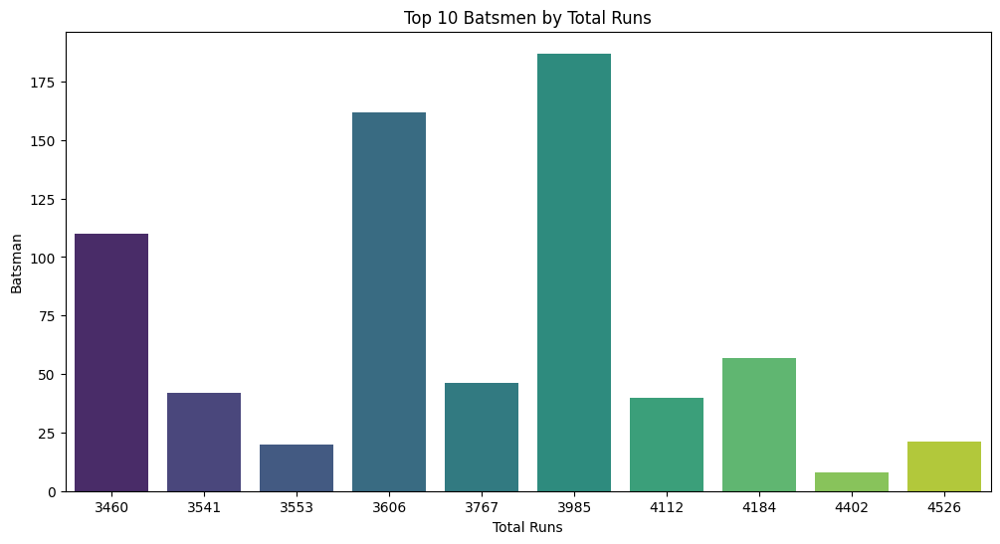

In [0]:
# Visualize the top 10 batsmen
top_10_batsmen_pd = top_10_batsmen.toPandas()

plt.figure(figsize=(12, 6))
sns.barplot(
    x='total_runs',
    y='striker',
    data=top_10_batsmen_pd,
    palette='viridis'
)
plt.title('Top 10 Batsmen by Total Runs')
plt.xlabel('Total Runs')
plt.ylabel('Batsman')
plt.show()

In [0]:
# Analyze the most economical bowlers during powerplay overs (overs 1-6)
economical_bowlers_powerplay = spark.sql("""
SELECT 
    p.player_name,                     -- Get bowler's name
    AVG(b.runs_scored) AS avg_runs_per_ball,  -- Calculate economy rate (average runs per ball)
    COUNT(b.bowler_wicket) AS total_wickets   -- Count total wickets taken
FROM ball_by_ball b                    -- Start with ball-by-ball data
JOIN player_match pm ON b.match_id = pm.match_id AND b.bowler = pm.player_id  -- Link bowler to match
JOIN player p ON pm.player_id = p.player_id    -- Get bowler's name from player ID
WHERE b.over_id <= 6                   -- Filter for powerplay overs (first 6 overs)
GROUP BY p.player_name                 -- Aggregate statistics per bowler
HAVING COUNT(*) >= 1                   -- Ensure bowler has at least 1 ball in powerplay
ORDER BY avg_runs_per_ball, total_wickets DESC  -- Sort by economy (lowest first), then wickets (highest first)
""")

In [0]:
economical_bowlers_powerplay.show()

+---------------+------------------+-------------+
|    player_name| avg_runs_per_ball|total_wickets|
+---------------+------------------+-------------+
|     sm harwood|0.3333333333333333|           18|
|     avesh khan|               0.5|           12|
|        a zampa|               0.5|            6|
|      gr napier|               0.5|            6|
|       aj finch|               0.5|            6|
|     ankit soni|               0.5|            6|
|       nb singh|0.5833333333333334|           24|
|     ag murtaza|0.6538461538461539|           78|
|      sb bangar|0.6666666666666666|           18|
|     d du preez|0.6666666666666666|           18|
|        s gopal|0.6666666666666666|            6|
|     fh edwards|0.6923076923076923|           78|
|       a kumble|0.7685185185185185|          108|
|       umar gul|0.7777777777777778|           36|
|j syed mohammad|0.7777777777777778|           18|
|   kp pietersen|0.7777777777777778|           18|
|    rj peterson|0.833333333333

In [0]:
# Analyze the impact of winning the toss on individual match results
toss_impact_individual_matches = spark.sql("""
SELECT 
    m.match_id,                       -- Unique identifier for each match
    m.toss_winner,                    -- Team that won the toss
    m.toss_name,                      -- Toss decision (batting or fielding)
    m.match_winner,                   -- Team that won the match
    CASE                              -- Calculate match outcome from toss winner's perspective
        WHEN m.toss_winner = m.match_winner THEN 'Won' 
        ELSE 'Lost' 
    END AS match_outcome              -- Result: 'Won' if toss winner won match, 'Lost' otherwise
FROM match m
WHERE m.toss_name IS NOT NULL         -- Filter out matches with missing toss decisions
ORDER BY m.match_id                   -- Sort by match ID for chronological order
""")

In [0]:
toss_impact_individual_matches.show()

+--------+--------------------+---------+--------------------+-------------+
|match_id|         toss_winner|toss_name|        match_winner|match_outcome|
+--------+--------------------+---------+--------------------+-------------+
|  335987|Royal Challengers...|    field|Kolkata Knight Ri...|         Lost|
|  335988| Chennai Super Kings|      bat| Chennai Super Kings|          Won|
|  335989|    Rajasthan Royals|      bat|    Delhi Daredevils|         Lost|
|  335990|      Mumbai Indians|      bat|Royal Challengers...|         Lost|
|  335991|     Deccan Chargers|      bat|Kolkata Knight Ri...|         Lost|
|  335992|     Kings XI Punjab|      bat|    Rajasthan Royals|         Lost|
|  335993|     Deccan Chargers|      bat|    Delhi Daredevils|         Lost|
|  335994|      Mumbai Indians|    field| Chennai Super Kings|         Lost|
|  335995|    Rajasthan Royals|    field|    Rajasthan Royals|          Won|
|  335996|      Mumbai Indians|    field|     Kings XI Punjab|         Lost|

In [0]:
# Calculate average runs scored by players specifically in matches their team won
average_runs_in_wins = spark.sql("""
SELECT 
    p.player_name,                     -- Player name for readability
    AVG(b.runs_scored) AS avg_runs_in_wins,  -- Average runs per ball in winning matches
    COUNT(*) AS innings_played         -- Total balls faced in winning matches (proxy for innings)
FROM ball_by_ball b
JOIN player_match pm ON b.match_id = pm.match_id AND b.striker = pm.player_id  -- Link striker to match
JOIN player p ON pm.player_id = p.player_id      -- Get player name
JOIN match m ON pm.match_id = m.match_id         -- Get match outcome data
WHERE m.match_winner = pm.player_team            -- Filter only matches where player's team WON
GROUP BY p.player_name                 -- Aggregate statistics per player
ORDER BY avg_runs_in_wins ASC          -- Sort by lowest average runs first (ascending order)
""")

In [0]:
average_runs_in_wins.show()

+-----------------+-------------------+--------------+
|      player_name|   avg_runs_in_wins|innings_played|
+-----------------+-------------------+--------------+
|         ts mills|                0.0|             3|
|         i sharma|                0.0|             1|
|        jj bumrah|                0.0|             2|
|        sn thakur|                0.0|             2|
|          a nehra|                0.0|             2|
|         j theron|                0.0|             1|
|         vr aaron|                0.0|             5|
|       kp appanna|                0.0|             1|
|    anirudh singh|                0.0|             1|
|       t thushara|                0.2|             5|
|        sa abbott|               0.25|             4|
|    yashpal singh| 0.3157894736842105|            19|
|      kc cariappa| 0.3333333333333333|             3|
|      s sreesanth| 0.3333333333333333|             3|
|       jd unadkat|                0.4|             5|
|       sm

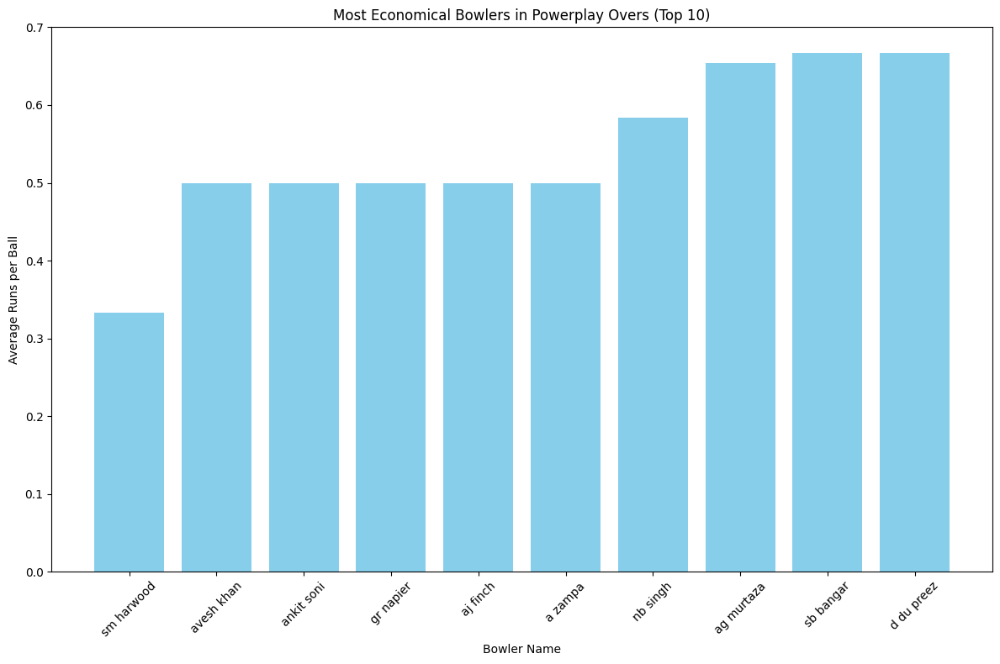

In [0]:
# Convert Spark DataFrame to Pandas for visualization
# This collects all data to the driver node, so ensure the dataset is not too large
economical_bowlers_pd = economical_bowlers_powerplay.toPandas()

# Visualizing using Matplotlib
plt.figure(figsize=(12, 8))

# Filter to top 10 most economical bowlers for better readability
# Using nsmallest() since lower average runs per ball indicates better economy
top_economical_bowlers = economical_bowlers_pd.nsmallest(10, 'avg_runs_per_ball')

# Create bar chart with appropriate styling
plt.bar(
    top_economical_bowlers['player_name'], 
    top_economical_bowlers['avg_runs_per_ball'], 
    color='skyblue'
    )
plt.xlabel('Bowler Name')
plt.ylabel('Average Runs per Ball')
plt.title('Most Economical Bowlers in Powerplay Overs (Top 10)')

# Rotate x-axis labels for better readability of bowler names
plt.xticks(rotation=45)

# Adjust layout to prevent label clipping
plt.tight_layout()
plt.show()


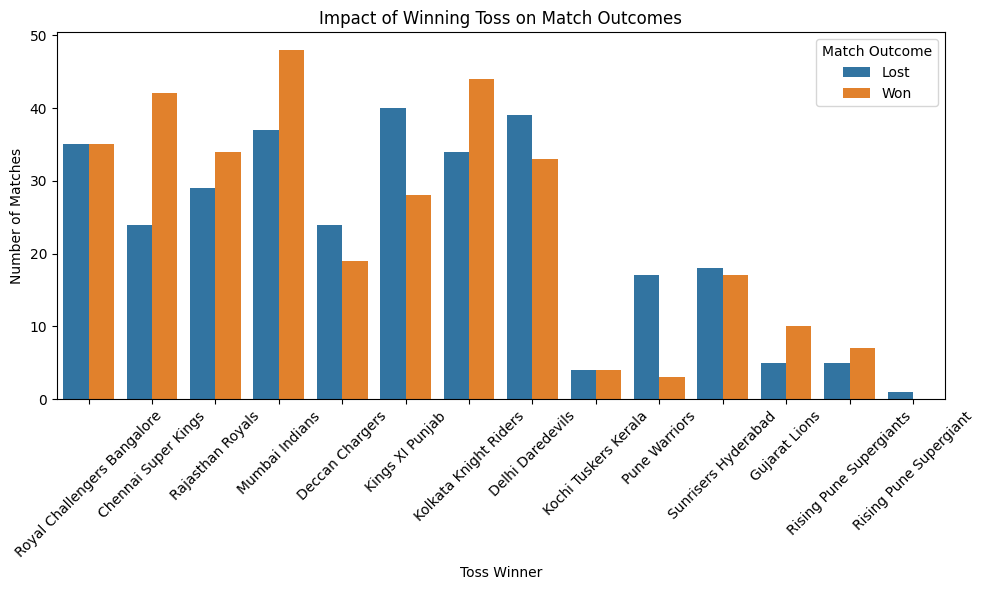

In [0]:
# Convert Spark DataFrame to Pandas for visualization with seaborn
toss_impact_pd = toss_impact_individual_matches.toPandas()

# Creating a countplot to show win/loss after winning toss
plt.figure(figsize=(10, 6))

# Create a countplot showing the relationship between toss winners and match outcomes
# This visualization effectively compares how often toss winners win vs lose matches
sns.countplot(
    x='toss_winner',
    hue='match_outcome', 
    data=toss_impact_pd
    )

plt.title('Impact of Winning Toss on Match Outcomes')
plt.xlabel('Toss Winner')  # Represents the team that won the toss
plt.ylabel('Number of Matches')  # Count of matches for each category
plt.legend(title='Match Outcome')  # Legend shows win/loss categories
plt.xticks(rotation=45)  # Rotate team names for better readability

plt.tight_layout()
plt.show()

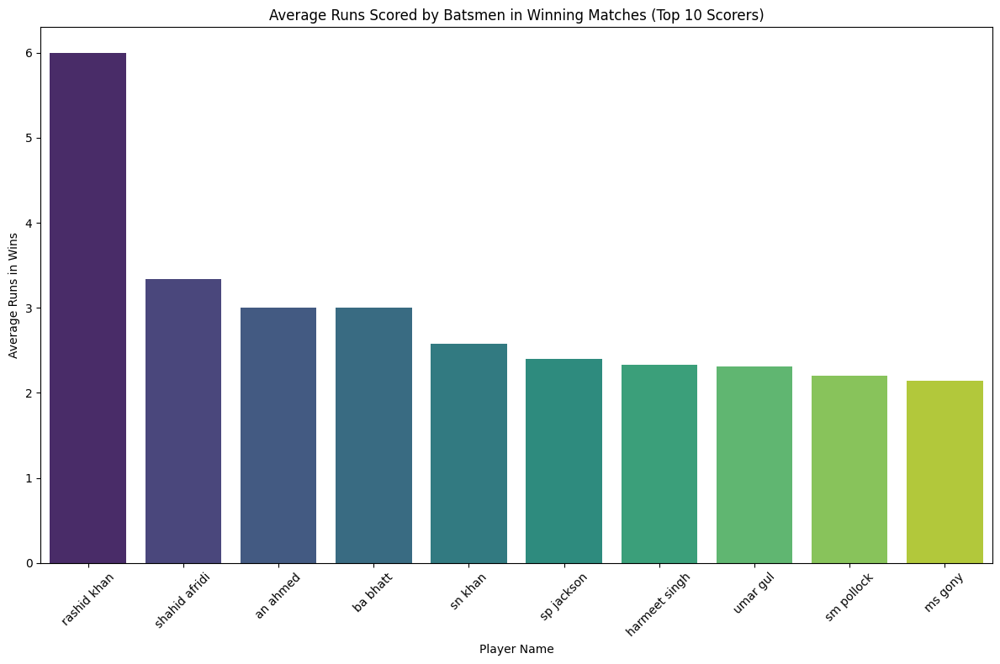

In [0]:
# Convert Spark DataFrame to Pandas for visualization
average_runs_pd = average_runs_in_wins.toPandas()

# Using seaborn to plot average runs in winning matches
plt.figure(figsize=(12, 8))

# Filter to top 10 performers for focused analysis
# Using nlargest() to identify players with highest average in winning matches
top_scorers = average_runs_pd.nlargest(10, 'avg_runs_in_wins')

# Create bar plot using seaborn for better aesthetics
sns.barplot(
    x='player_name', 
    y='avg_runs_in_wins', 
    data=top_scorers,
    palette='viridis'
    )

plt.title('Average Runs Scored by Batsmen in Winning Matches (Top 10 Scorers)')
plt.xlabel('Player Name')
plt.ylabel('Average Runs in Wins')  # Represents mean runs when their team wins
plt.xticks(rotation=45)  # Rotate names for readability

plt.tight_layout()
plt.show()

In [0]:
# Calculate scoring patterns by venue to identify high-scoring and low-scoring grounds
scores_by_venue = spark.sql("""
SELECT 
    venue_name,                       -- Name of the cricket ground/stadium
    AVG(total_runs) AS average_score, -- Average total runs per match at this venue
    MAX(total_runs) AS highest_score  -- Highest total runs ever recorded at this venue
FROM (
    -- Subquery: Calculate total runs for each individual match at each venue
    SELECT 
        ball_by_ball.match_id,        -- Unique match identifier
        match.venue_name,             -- Venue where match was played
        SUM(runs_scored) AS total_runs -- Total runs scored in the entire match
    FROM ball_by_ball
    JOIN match ON ball_by_ball.match_id = match.match_id  -- Link to get venue information
    GROUP BY ball_by_ball.match_id, match.venue_name      -- Group by match and venue
) match_scores                         -- Name of the subquery result set
GROUP BY venue_name                   -- Aggregate statistics per venue
ORDER BY average_score DESC           -- Sort by highest average scoring venues first
""")

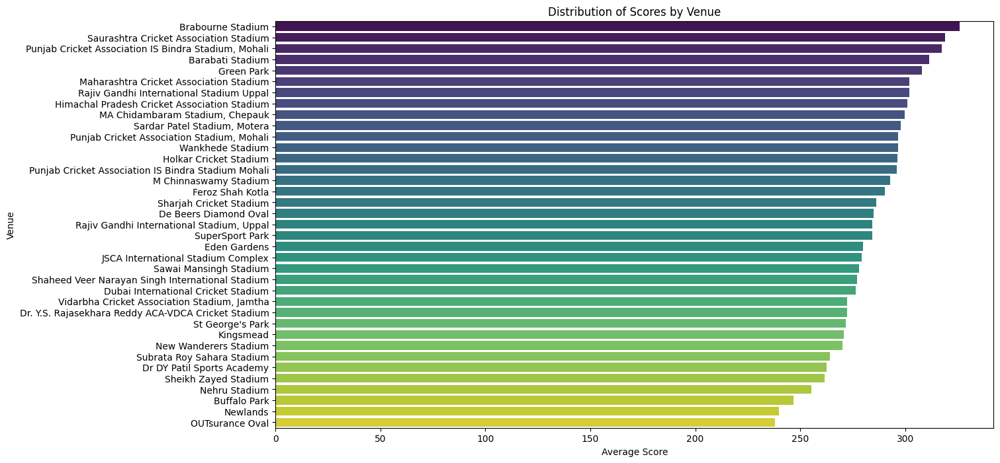

In [0]:
# Convert Spark DataFrame to Pandas DataFrame for visualization
# This collects the data to the driver node and converts it to Pandas format
scores_by_venue_pd = scores_by_venue.toPandas()

# Create visualization using matplotlib and seaborn
plt.figure(figsize=(14, 8))  # Set figure size for better readability

# Create horizontal bar plot to compare average scores across venues
sns.barplot(
    x='average_score',  # Use average score as x-axis (numerical values)
    y='venue_name',     # Use venue names as y-axis (categorical values)  
    data=scores_by_venue_pd, # Use the converted Pandas DataFrame
    palette='viridis'
)

# Customize plot labels and title for clarity
plt.title('Distribution of Scores by Venue')  # Main title
plt.xlabel('Average Score')                   # X-axis label (average runs per match)
plt.ylabel('Venue')                           # Y-axis label (stadium names)

# Display the plot
plt.show()

In [0]:
# Analyze the frequency of different dismissal types in IPL matches
dismissal_types = spark.sql("""
SELECT 
    out_type,                    -- Type of dismissal (caught, bowled, run out, etc.)
    COUNT(*) AS frequency        -- Count how many times each dismissal occurred
FROM ball_by_ball
WHERE out_type IS NOT NULL       -- Filter only balls where a wicket was taken (dismissal occurred)
GROUP BY out_type               -- Group by dismissal type to count occurrences
ORDER BY frequency DESC         -- Sort from most common to least common dismissal type
""")

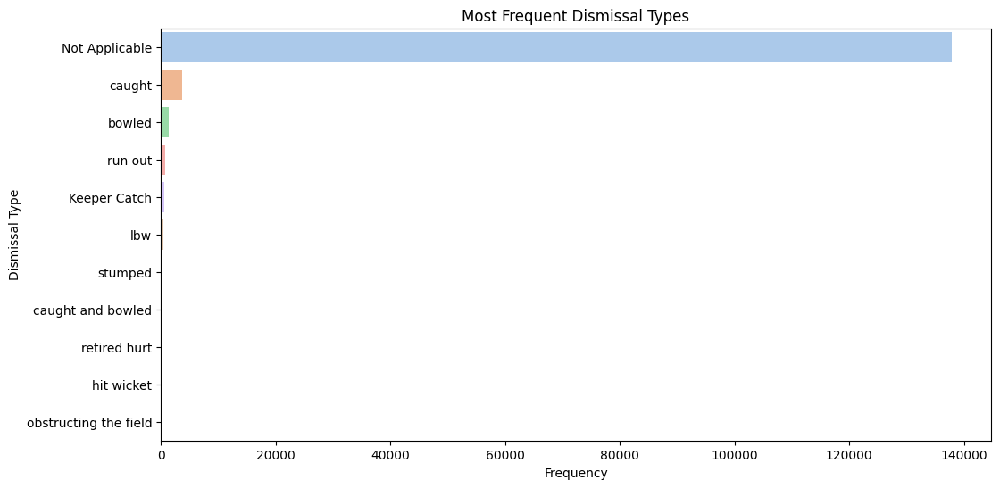

In [0]:
# Convert Spark DataFrame to Pandas DataFrame for visualization with matplotlib/seaborn
dismissal_types_pd = dismissal_types.toPandas()

# Create a visualization to show the frequency of different dismissal types
plt.figure(figsize=(12, 6))  # Set figure dimensions for optimal readability

# Create horizontal bar plot using seaborn
sns.barplot(
    x='frequency',           # X-axis: count of each dismissal type
    y='out_type',            # Y-axis: different types of dismissals
    data=dismissal_types_pd, # Use the converted Pandas DataFrame
    palette='pastel'         # Use soft, pastel colors for visual appeal
)

# Customize chart labels and title
plt.title('Most Frequent Dismissal Types')  # Chart title
plt.xlabel('Frequency')                     # X-axis label (number of occurrences)
plt.ylabel('Dismissal Type')                # Y-axis label (types of dismissals)

# Display the final visualization
plt.show()

In [0]:
# Analyze team performance when winning the toss (with logical correction)
team_toss_win_performance = spark.sql("""
SELECT 
    team1,                              -- Team name (assuming team1 is the toss winner)
    COUNT(*) AS matches_played,         -- Total matches where team won toss
    SUM(CASE 
        WHEN toss_winner = match_winner THEN 1 
        ELSE 0 
    END) AS wins_after_toss            -- Count matches where toss winner also won match
FROM match
WHERE toss_winner = team1               -- where toss_winner is always team1
GROUP BY team1
ORDER BY wins_after_toss DESC           -- Sort by most wins after winning toss
""")





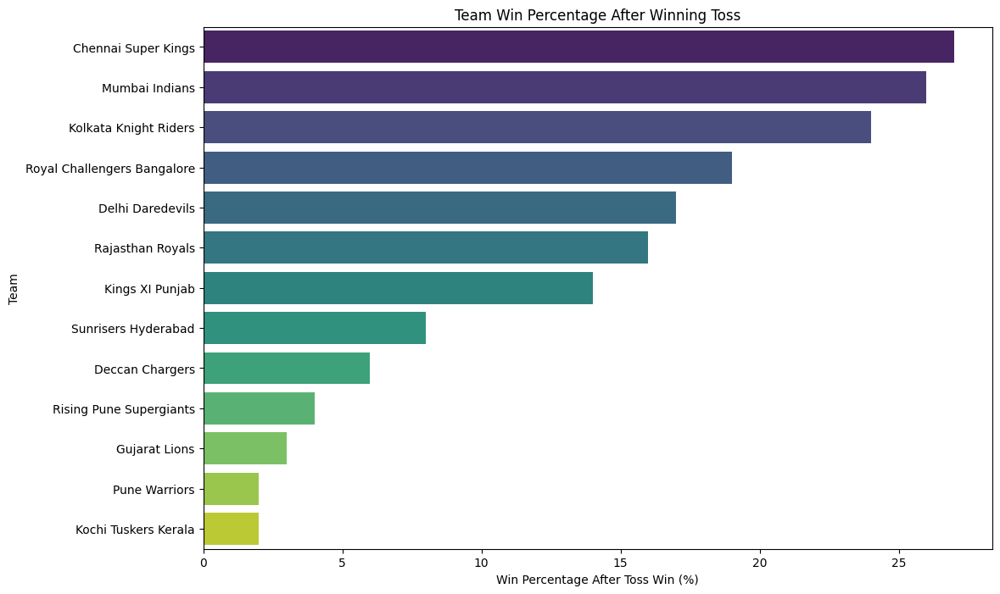

In [0]:
# Visualization for the CORRECTED query analysis
team_toss_win_pd = team_toss_win_performance.toPandas()

plt.figure(figsize=(12, 8))
sns.barplot(
    x='wins_after_toss',  # Use percentage instead of raw counts
    y='team1',                       # Use 'team' column from corrected query
    data=team_toss_win_pd,
    palette='viridis'
)
plt.title('Team Win Percentage After Winning Toss')
plt.xlabel('Win Percentage After Toss Win (%)')
plt.ylabel('Team')
plt.show()